# The Battle of the Neighborhoods

## Naveen Ram

In this project I will take a look at the Foursquare API. I will combine these in looking at the 314 largest cities in the US population-wise. Then I will cluster the cities based on this information to provide insight to users about what cities are similar to the ones that they want. 

In [3]:
# first I will import the necesarry libraries

from bs4 import BeautifulSoup
import pandas as pd
import requests

### Step 1: Retrieve data

First, I will need to retrieve data from the multiple sources I will be using. I will use beautiful soup and the requests packages to scrape the wikipedia site for the list of the largest US cities by population. Next, I will get longitude and latitude data from the geocoders package. Lastly, I will get data from the Foursquare explore API using the longitude and latitude data.

In [4]:
# Now I will get information from the table on the wikipedia page

link = 'https://en.wikipedia.org/wiki/List_of_United_States_cities_by_population'
response = requests.get(link)
response

<Response [200]>

In [5]:
# Now I will use Beautiful Soup to scrape this page for the table information
soup = BeautifulSoup(response.text, "html.parser")
from IPython.display import display_html
table = str(soup.findAll('table')[4])
display_html(table, raw=True)

2018 rank
 
 City
 
 State [c] 
 
 2018 estimate
 
 2010 Census
 
 Change
 
 2016 land area
 
 2016 population density
 
 Location
 
 
 1
 
 New York [d] 
 
   New York 
 
 8,398,748
 
 8,175,133
 
 +2.74% 
 
 301.5 sq mi
 
 780.9 km 2 
 
 28,317/sq mi
 
 10,933/km 2 
 
 40°39′49″N 73°56′19″W ﻿ / ﻿ 40.6635°N 73.9387°W ﻿ / 40.6635; -73.9387 ﻿ ( 1 New York City ) 
 
 
 2
 
 Los Angeles 
 
   California 
 
 3,990,456
 
 3,792,621
 
 +5.22% 
 
 468.7 sq mi
 
 1,213.9 km 2 
 
 8,484/sq mi
 
 3,276/km 2 
 
 34°01′10″N 118°24′39″W ﻿ / ﻿ 34.0194°N 118.4108°W ﻿ / 34.0194; -118.4108 ﻿ ( 2 Los Angeles ) 
 
 
 3
 
 Chicago 
 
   Illinois 
 
 2,705,994
 
 2,695,598
 
 +0.39% 
 
 227.3 sq mi
 
 588.7 km 2 
 
 11,900/sq mi
 
 4,600/km 2 
 
 41°50′15″N 87°40′54″W ﻿ / ﻿ 41.8376°N 87.6818°W ﻿ / 41.8376; -87.6818 ﻿ ( 3 Chicago ) 
 
 
 4
 
 Houston [3] 
 
   Texas 
 
 2,325,502
 
 2,100,263
 
 +10.72% 
 
 637.5 sq mi
 
 1,651.1 km 2 
 
 3,613/sq mi
 
 1,395/km 2 
 
 29°47′12″N 95°23′27″W ﻿ / ﻿ 29.7866°N 95.3909°W ﻿ / 29.7866; -95.3909 ﻿ ( 4 Houston ) 
 
 
 5
 
 Phoenix 
 
   Arizona 
 
 1,660,272
 
 1,445,632
 
 +14.85% 
 
 517.6 sq mi
 
 1,340.6 km 2 
 
 3,120/sq mi
 
 1,200/km 2 
 
 33°34′20″N 112°05′24″W ﻿ / ﻿ 33.5722°N 112.0901°W ﻿ / 33.5722; -112.0901 ﻿ ( 6 Phoenix ) 
 
 
 6
 
 Philadelphia [e] 
 
   Pennsylvania 
 
 1,584,138
 
 1,526,006
 
 +3.81% 
 
 134.2 sq mi
 
 347.6 km 2 
 
 11,683/sq mi
 
 4,511/km 2 
 
 40°00′34″N 75°08′00″W ﻿ / ﻿ 40.0094°N 75.1333°W ﻿ / 40.0094; -75.1333 ﻿ ( 5 Philadelphia ) 
 
 
 7
 
 San Antonio 
 
   Texas
 
 1,532,233
 
 1,327,407
 
 +15.43% 
 
 461.0 sq mi
 
 1,194.0 km 2 
 
 3,238/sq mi
 
 1,250/km 2 
 
 29°28′21″N 98°31′30″W ﻿ / ﻿ 29.4724°N 98.5251°W ﻿ / 29.4724; -98.5251 ﻿ ( 7 San Antonio ) 
 
 
 8
 
 San Diego 
 
   California
 
 1,425,976
 
 1,307,402
 
 +9.07% 
 
 325.2 sq mi
 
 842.3 km 2 
 
 4,325/sq mi
 
 1,670/km 2 
 
 32°48′55″N 117°08′06″W ﻿ / ﻿ 32.8153°N 117.1350°W ﻿ / 32.8153; -117.1350 ﻿ ( 8 San Diego ) 
 
 
 9
 
 Dallas 
 
   Texas
 
 1,345,047
 
 1,197,816
 
 +12.29% 
 
 340.9 sq mi
 
 882.9 km 2 
 
 3,866/sq mi
 
 1,493/km 2 
 
 32°47′36″N 96°45′59″W ﻿ / ﻿ 32.7933°N 96.7665°W ﻿ / 32.7933; -96.7665 ﻿ ( 9 Dallas ) 
 
 
 10
 
 San Jose 
 
   California
 
 1,030,119
 
 945,942
 
 +8.90% 
 
 177.5 sq mi
 
 459.7 km 2 
 
 5,777/sq mi
 
 2,231/km 2 
 
 37°17′48″N 121°49′08″W ﻿ / ﻿ 37.2967°N 121.8189°W ﻿ / 37.2967; -121.8189 ﻿ ( 10 San Jose ) 
 
 
 11
 
 Austin 
 
   Texas
 
 964,254
 
 790,390
 
 +22.00% 
 
 312.7 sq mi
 
 809.9 km 2 
 
 3,031/sq mi
 
 1,170/km 2 
 
 30°18′14″N 97°45′16″W ﻿ / ﻿ 30.3039°N 97.7544°W ﻿ / 30.3039; -97.7544 ﻿ ( 11 Austin ) 
 
 
 12
 
 Jacksonville [f] 
 
   Florida 
 
 903,889
 
 821,784
 
 +9.99% 
 
 747.4 sq mi
 
 1,935.8 km 2 
 
 1,178/sq mi
 
 455/km 2 
 
 30°20′13″N 81°39′42″W ﻿ / ﻿ 30.3369°N 81.6616°W ﻿ / 30.3369; -81.6616 ﻿ ( 12 Jacksonville ) 
 
 
 13
 
 Fort Worth 
 
   Texas
 
 895,008
 
 741,206
 
 +20.75% 
 
 342.9 sq mi
 
 888.1 km 2 
 
 2,491/sq mi
 
 962/km 2 
 
 32°46′53″N 97°20′48″W ﻿ / ﻿ 32.7815°N 97.3467°W ﻿ / 32.7815; -97.3467 ﻿ ( 16 Fort Worth ) 
 
 
 14
 
 Columbus 
 
   Ohio 
 
 892,533
 
 787,033
 
 +13.40% 
 
 218.5 sq mi
 
 565.9 km 2 
 
 3,936/sq mi
 
 1,520/km 2 
 
 39°59′07″N 82°59′05″W ﻿ / ﻿ 39.9852°N 82.9848°W ﻿ / 39.9852; -82.9848 ﻿ ( 15 Columbus ) 
 
 
 15
 
 San Francisco [g] 
 
   California
 
 883,305
 
 805,235
 
 +9.70% 
 
 46.9 sq mi
 
 121.5 km 2 
 
 18,569/sq mi
 
 7,170/km 2 
 
 37°43′38″N 123°01′56″W ﻿ / ﻿ 37.7272°N 123.0322°W ﻿ / 37.7272; -123.0322 ﻿ ( 13 San Francisco ) 
 
 
 16
 
 Charlotte 
 
   North Carolina 
 
 872,498
 
 731,424
 
 +19.29% 
 
 305.4 sq mi
 
 791.0 km 2 
 
 2,757/sq mi
 
 1,064/km 2 
 
 35°12′28″N 80°49′52″W ﻿ / ﻿ 35.2078°N 80.8310°W ﻿ / 35.2078; -80.8310 ﻿ ( 17 Charlotte ) 
 
 
 17
 
 Indianapolis [h] 
 
   Indiana 
 
 867,125
 
 820,445
 
 +5.69% 
 
 361.5 sq mi
 
 936.3 km 2 
 
 2,366/sq mi
 
 914/km 2 
 
 39°46′36″N 86°08′45″W ﻿ / ﻿ 39.7767°N 86.1459°W ﻿ / 39.7767; -86.1459 ﻿ ( 14 Indianapolis ) 
 
 

In [6]:
#Next I am converting this information to a DataFrame
dfs = pd.read_html(table, header=0)
df = dfs[0]
df.head()

,2018rank,City,State[c],2018estimate,2010Census,Change,2016 land area,2016 land area.1,2016 population density,2016 population density.1,Location
0,1,New York[d],New York,8398748,8175133,+2.74%,301.5 sq mi,780.9 km2,"28,317/sq mi","10,933/km2",40°39′49″N 73°56′19″W﻿ / ﻿40.6635°N 73.9387°W
1,2,Los Angeles,California,3990456,3792621,+5.22%,468.7 sq mi,"1,213.9 km2","8,484/sq mi","3,276/km2",34°01′10″N 118°24′39″W﻿ / ﻿34.0194°N 118.4108°W
2,3,Chicago,Illinois,2705994,2695598,+0.39%,227.3 sq mi,588.7 km2,"11,900/sq mi","4,600/km2",41°50′15″N 87°40′54″W﻿ / ﻿41.8376°N 87.6818°W
3,4,Houston[3],Texas,2325502,2100263,+10.72%,637.5 sq mi,"1,651.1 km2","3,613/sq mi","1,395/km2",29°47′12″N 95°23′27″W﻿ / ﻿29.7866°N 95.3909°W
4,5,Phoenix,Arizona,1660272,1445632,+14.85%,517.6 sq mi,"1,340.6 km2","3,120/sq mi","1,200/km2",33°34′20″N 112°05′24″W﻿ / ﻿33.5722°N 112.0901°W


In [7]:
# Updating City values to uniform format
df['City'] = df['City'].map(lambda x: x[:x.find('[')] if '[' in x else x)

In [8]:
df.head()

,2018rank,City,State[c],2018estimate,2010Census,Change,2016 land area,2016 land area.1,2016 population density,2016 population density.1,Location
0,1,New York,New York,8398748,8175133,+2.74%,301.5 sq mi,780.9 km2,"28,317/sq mi","10,933/km2",40°39′49″N 73°56′19″W﻿ / ﻿40.6635°N 73.9387°W
1,2,Los Angeles,California,3990456,3792621,+5.22%,468.7 sq mi,"1,213.9 km2","8,484/sq mi","3,276/km2",34°01′10″N 118°24′39″W﻿ / ﻿34.0194°N 118.4108°W
2,3,Chicago,Illinois,2705994,2695598,+0.39%,227.3 sq mi,588.7 km2,"11,900/sq mi","4,600/km2",41°50′15″N 87°40′54″W﻿ / ﻿41.8376°N 87.6818°W
3,4,Houston,Texas,2325502,2100263,+10.72%,637.5 sq mi,"1,651.1 km2","3,613/sq mi","1,395/km2",29°47′12″N 95°23′27″W﻿ / ﻿29.7866°N 95.3909°W
4,5,Phoenix,Arizona,1660272,1445632,+14.85%,517.6 sq mi,"1,340.6 km2","3,120/sq mi","1,200/km2",33°34′20″N 112°05′24″W﻿ / ﻿33.5722°N 112.0901°W


In [9]:
#drop the unimportant columns
df.drop(df.columns.difference(['City','State[c]','2018estimate']), 1, inplace=True)
df.head()

,City,State[c],2018estimate
0,New York,New York,8398748
1,Los Angeles,California,3990456
2,Chicago,Illinois,2705994
3,Houston,Texas,2325502
4,Phoenix,Arizona,1660272


In [10]:
#rename columns
df.columns = ['City','State','Population']
df.head()

,City,State,Population
0,New York,New York,8398748
1,Los Angeles,California,3990456
2,Chicago,Illinois,2705994
3,Houston,Texas,2325502
4,Phoenix,Arizona,1660272


In [11]:
#obtaining longitude and latitude data using the geopy.geocoders API
from geopy.geocoders import Nominatim
geolocator = Nominatim(user_agent="my-application")
def find_geo_coord(city, state):
    address = "%s, %s" % (city, state)
    location = geolocator.geocode(address, timeout=10)
    latitude = location.latitude
    longitude = location.longitude
    return latitude,longitude

In [12]:
data = [find_geo_coord(x, y) for x, y in zip(df['City'], df['State'])]

In [13]:
#add retrieved data to original data frame
df2 = pd.DataFrame(data, columns=['Latitude','Longitude'])
cities = pd.concat([df, df2], axis=1)
cities.head()

,City,State,Population,Latitude,Longitude
0,New York,New York,8398748,40.712728,-74.006015
1,Los Angeles,California,3990456,34.053691,-118.242767
2,Chicago,Illinois,2705994,41.875562,-87.624421
3,Houston,Texas,2325502,29.758938,-95.367697
4,Phoenix,Arizona,1660272,33.448587,-112.077346


In [14]:
#Get the abbreviation for the state
us_state_abbrev = {
    'Alabama': 'AL',
    'Alaska': 'AK',
    'Arizona': 'AZ',
    'Arkansas': 'AR',
    'California': 'CA',
    'Colorado': 'CO',
    'Connecticut': 'CT',
    'Delaware': 'DE',
    'District of Columbia': 'DC',
    'Florida': 'FL',
    'Georgia': 'GA',
    'Hawaii': 'HI',
    'Idaho': 'ID',
    'Illinois': 'IL',
    'Indiana': 'IN',
    'Iowa': 'IA',
    'Kansas': 'KS',
    'Kentucky': 'KY',
    'Louisiana': 'LA',
    'Maine': 'ME',
    'Maryland': 'MD',
    'Massachusetts': 'MA',
    'Michigan': 'MI',
    'Minnesota': 'MN',
    'Mississippi': 'MS',
    'Missouri': 'MO',
    'Montana': 'MT',
    'Nebraska': 'NE',
    'Nevada': 'NV',
    'New Hampshire': 'NH',
    'New Jersey': 'NJ',
    'New Mexico': 'NM',
    'New York': 'NY',
    'North Carolina': 'NC',
    'North Dakota': 'ND',
    'Northern Mariana Islands':'MP',
    'Ohio': 'OH',
    'Oklahoma': 'OK',
    'Oregon': 'OR',
    'Palau': 'PW',
    'Pennsylvania': 'PA',
    'Puerto Rico': 'PR',
    'Rhode Island': 'RI',
    'South Carolina': 'SC',
    'South Dakota': 'SD',
    'Tennessee': 'TN',
    'Texas': 'TX',
    'Utah': 'UT',
    'Vermont': 'VT',
    'Virgin Islands': 'VI',
    'Virginia': 'VA',
    'Washington': 'WA',
    'West Virginia': 'WV',
    'Wisconsin': 'WI',
    'Wyoming': 'WY',
}
cities['State'] = cities['State'].map(lambda x:  us_state_abbrev[x])
cities.head()

,City,State,Population,Latitude,Longitude
0,New York,NY,8398748,40.712728,-74.006015
1,Los Angeles,CA,3990456,34.053691,-118.242767
2,Chicago,IL,2705994,41.875562,-87.624421
3,Houston,TX,2325502,29.758938,-95.367697
4,Phoenix,AZ,1660272,33.448587,-112.077346


In [16]:
#Function to retrieve data from Foursquare API 
import json
def getNearbyVenues(city, state, population, latitudes, longitudes, radius=500):
    venues_list=[]
    for c, s, pop, lat, lng in zip(city, state, population, latitudes, longitudes):
        print(c,s)
            
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore'

        params = dict(
          client_id='WMOW0BTP12H4ELYHMYSF4PJSJ0VM5BWO3NQCTLQT1QCEYSXM',
          client_secret='RGZW3UBF5JMOSGT5A2FZY5ZILIRSGRBYHFLZBTZKJLEK52ZK',
          v='20180323',
          ll=str(lat)+','+str(lng),
          limit=100,
          radius=2500

        )
        resp = requests.get(url=url, params=params)
        results = json.loads(resp.text)["response"]['groups'][0]['items']
        
        # return only relevant information for each nearby venue
        venues_list.append([(
            c,
            s,
            pop,
            lat, 
            lng, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in results])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['City',
                  'State',
                  'Population',           
                  'City Latitude', 
                  'City Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    
    return(nearby_venues)

In [37]:
cities_venues = getNearbyVenues(cities['City'],cities['State'],cities['Population'],cities['Latitude'],cities['Longitude'])

New York NY
Los Angeles CA
Chicago IL
Houston TX
Phoenix AZ
Philadelphia PA
San Antonio TX
San Diego CA
Dallas TX
San Jose CA
Austin TX
Jacksonville FL
Fort Worth TX
Columbus OH
San Francisco CA
Charlotte NC
Indianapolis IN
Seattle WA
Denver CO
Washington DC
Boston MA
El Paso TX
Detroit MI
Nashville TN
Portland OR
Memphis TN
Oklahoma City OK
Las Vegas NV
Louisville KY
Baltimore MD
Milwaukee WI
Albuquerque NM
Tucson AZ
Fresno CA
Mesa AZ
Sacramento CA
Atlanta GA
Kansas City MO
Colorado Springs CO
Miami FL
Raleigh NC
Omaha NE
Long Beach CA
Virginia Beach VA
Oakland CA
Minneapolis MN
Tulsa OK
Arlington TX
Tampa FL
New Orleans LA
Wichita KS
Cleveland OH
Bakersfield CA
Aurora CO
Anaheim CA
Honolulu HI
Santa Ana CA
Riverside CA
Corpus Christi TX
Lexington KY
Stockton CA
Henderson NV
Saint Paul MN
St. Louis MO
Cincinnati OH
Pittsburgh PA
Greensboro NC
Anchorage AK
Plano TX
Lincoln NE
Orlando FL
Irvine CA
Newark NJ
Toledo OH
Durham NC
Chula Vista CA
Fort Wayne IN
Jersey City NJ
St. Petersburg F

Now the cities_venues data contains venues for each of the 314 cities in the dataset. Each city has the amenities and attractions in a 25 km radius to the city. The resulting data frame 27,911 rows. A size which will be consiladated in the next step.

### Step 2: Data transformation

In this step, I need to get the data in a format that will allow me to pass it into the K means clustering algoithm. In this step I will combine the City and State columns into a single entry. Then I will convert the venue category data for each venue into a numerical value from a categorical one. This will then be averaged among all entries for the city to consolidate the cities by venue category. Lastly, the data frame will be rearranged to have the location at the front of the dataframe.

In [38]:
#save data
cities_venues.to_pickle("data.pkl")

In [17]:
cities_venues = pd.read_pickle("data.pkl")

In [18]:
cities_venues.shape

(27911, 9)

In [19]:
cities_venues.head()

,City,State,Population,City Latitude,City Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,New York,NY,8398748,40.712728,-74.006015,The Bar Room at Temple Court,40.711448,-74.006802,Hotel Bar
1,New York,NY,8398748,40.712728,-74.006015,The Beekman - A Thompson Hotel,40.711173,-74.006702,Hotel
2,New York,NY,8398748,40.712728,-74.006015,Four Seasons Hotel New York Downtown,40.712612,-74.009380,Hotel
3,New York,NY,8398748,40.712728,-74.006015,Takahachi Bakery,40.713653,-74.008804,Bakery
4,New York,NY,8398748,40.712728,-74.006015,Pisillo Italian Panini,40.710530,-74.007526,Sandwich Place


In [20]:
# Consolidate state and city columns into location and remove the two columns

cities_venues['Location'] = cities_venues[['City', 'State']].apply(lambda x: ','.join(x.fillna('').map(str)), axis=1)

cities_venues.drop(['City','State'], axis=1, inplace=True)


In [21]:
cities_venues.head()

,Population,City Latitude,City Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category,Location
0,8398748,40.712728,-74.006015,The Bar Room at Temple Court,40.711448,-74.006802,Hotel Bar,"New York,NY"
1,8398748,40.712728,-74.006015,The Beekman - A Thompson Hotel,40.711173,-74.006702,Hotel,"New York,NY"
2,8398748,40.712728,-74.006015,Four Seasons Hotel New York Downtown,40.712612,-74.009380,Hotel,"New York,NY"
3,8398748,40.712728,-74.006015,Takahachi Bakery,40.713653,-74.008804,Bakery,"New York,NY"
4,8398748,40.712728,-74.006015,Pisillo Italian Panini,40.710530,-74.007526,Sandwich Place,"New York,NY"


In [22]:
# one hot encoding - convert the venue categories to numerical values
cities_onehot = pd.get_dummies(cities_venues[['Venue Category']], prefix="", prefix_sep="")

# add back the Location and Population data to the data frame
cities_onehot['Location'] = cities_venues['Location'] 
cities_onehot['Population'] = cities_venues['Population']

# insert location data as the first column of the data
mid = cities_onehot['Location']
cities_onehot.drop(labels=['Location'], axis=1,inplace = True)
cities_onehot.insert(0, 'Location', mid)



In [23]:
cities_onehot.head()
len(cities_onehot)

27911

In [24]:
cities_onehot.head()

,Location,ATM,Accessories Store,Adult Boutique,Advertising Agency,Afghan Restaurant,African Restaurant,Airport,Airport Terminal,Alternative Healer,...,Weight Loss Center,Whisky Bar,Wine Bar,Wine Shop,Winery,Wings Joint,Women's Store,Yoga Studio,Zoo,Population
0,"New York,NY",0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,8398748
1,"New York,NY",0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,8398748
2,"New York,NY",0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,8398748
3,"New York,NY",0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,8398748
4,"New York,NY",0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,8398748


In [25]:
#average the category to data to considate and normalize the data across each city
cities_grouped = cities_onehot.groupby('Location').mean().reset_index()
cities_grouped.head()

,Location,ATM,Accessories Store,Adult Boutique,Advertising Agency,Afghan Restaurant,African Restaurant,Airport,Airport Terminal,Alternative Healer,...,Weight Loss Center,Whisky Bar,Wine Bar,Wine Shop,Winery,Wings Joint,Women's Store,Yoga Studio,Zoo,Population
0,"Abilene,TX",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.019231,0.00,0.0,0.00,0.00,0.0,0.000000,122999
1,"Akron,OH",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.010000,0.00,0.0,0.00,0.00,0.0,0.020000,198006
2,"Albuquerque,NM",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.000000,0.00,0.0,0.00,0.00,0.0,0.011364,560218
3,"Alexandria,VA",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.000000,0.01,0.0,0.00,0.01,0.0,0.000000,160530
4,"Allen,TX",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.010000,0.00,0.0,0.02,0.01,0.0,0.000000,103383


In [26]:
cities_grouped.shape

(312, 518)

### Step 3: Visualization, Modeling and Results

Now we will use the Folium package to visualize the cities in the US. We then can apply the Kmeans alogrithm on the data to put the cities in clusters. We can than color code the map labels to show the clusters visually on the map. Lastly, we can look at individual results for cities and their recommendations. 

In [27]:
# longitude and latitude for the center of the US
center_lat = 39.110767
center_long = -94.589494

In [28]:
import folium
# create map of Manhattan using latitude and longitude values
map_usa = folium.Map(location=[center_lat, center_long], zoom_start=4)

In [29]:
map_usa

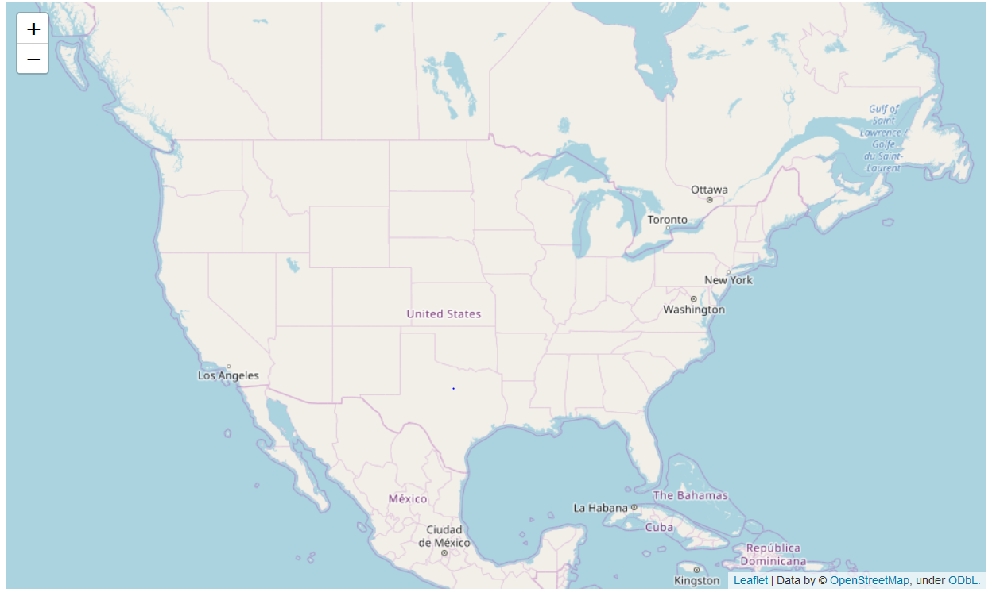

In [32]:
#show folium map
from IPython.display import Image
Image("pictures/1.png")

In [30]:
# add labels to the map for each city based on their latitude and longitude
for lat, lng, label in zip(cities_venues['City Latitude'], cities_venues['City Longitude'], cities_venues['Location']):
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_usa)  

In [31]:
map_usa

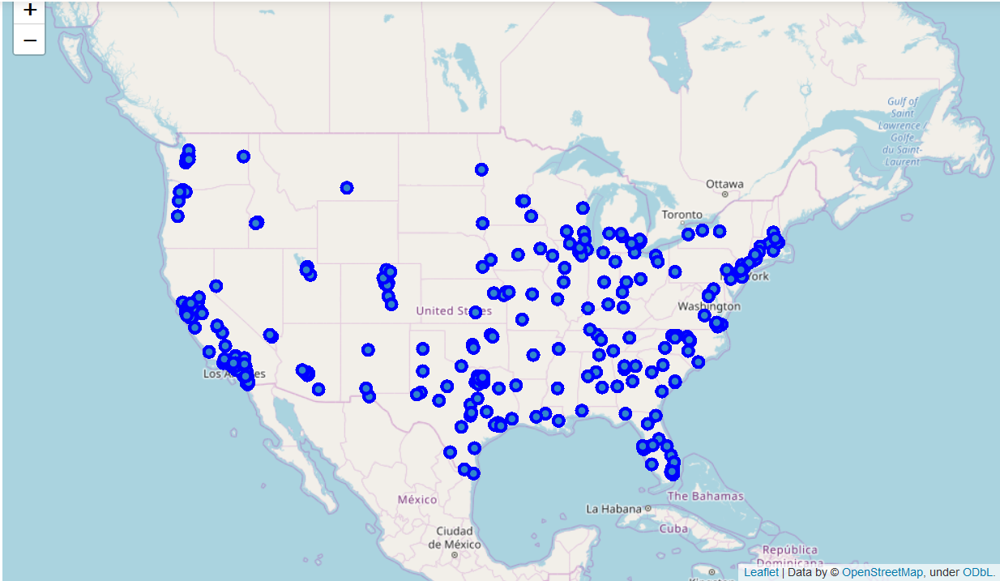

In [33]:
#show folium map
from IPython.display import Image
Image("pictures/2.png")

In [34]:
#cluster data using sklearn KMeans algorithm
from sklearn.cluster import KMeans
# set number of clusters
kclusters = 40

cities_grouped_clustering = cities_grouped.drop('Location', 1)

# run k-means clustering
kmeans = KMeans(n_clusters=kclusters, random_state=0).fit(cities_grouped_clustering)

Now that the data is clustered based on the grouped category data, we can now put this data on the map, and we can look at individual cities to get recommendations.

In [35]:
# create a new data frame with the label data
cities_label = pd.DataFrame(cities_grouped['Location'])

In [36]:
cities_label.insert(0,'Cluster Labels',kmeans.labels_)

In [37]:
cities_label.head()

,Cluster Labels,Location
0,31,"Abilene,TX"
1,29,"Akron,OH"
2,14,"Albuquerque,NM"
3,22,"Alexandria,VA"
4,33,"Allen,TX"


In [38]:
# add longitude, latitude data to the new cluster data fram
imp_info = cities_venues[['City Latitude', 'City Longitude', 'Location']]

In [39]:
cities_final = cities_label.merge(imp_info, on='Location')

In [40]:
cities_final = cities_final.drop_duplicates()

In [41]:
cities_final.head()

,Cluster Labels,Location,City Latitude,City Longitude
0,31,"Abilene,TX",32.446450,-99.747591
52,29,"Akron,OH",41.083064,-81.518485
152,14,"Albuquerque,NM",35.084103,-106.650985
240,22,"Alexandria,VA",38.814760,-77.090248
340,33,"Allen,TX",33.103174,-96.670550


In [42]:
# add color to the labels on the map according to their cluster.
import numpy as np
import matplotlib.cm as cm
import matplotlib.colors as colors
map_clusters = folium.Map(location=[center_lat, center_long], zoom_start=4)

# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(cities_final['City Latitude'], cities_final['City Longitude'], cities_final['Location'], cities_final['Cluster Labels']):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(map_clusters)
       
map_clusters

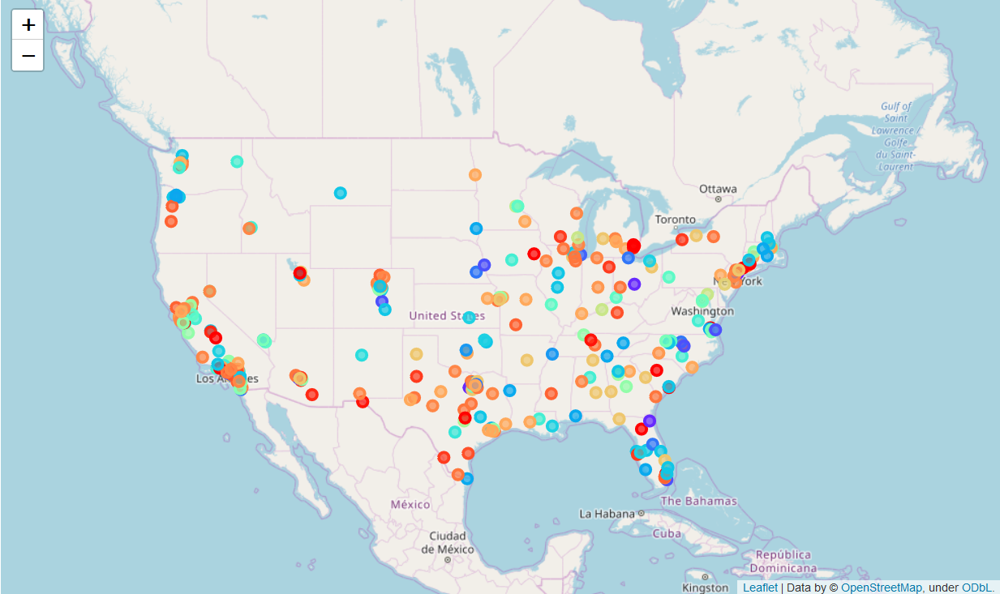

In [43]:
#show folium map
from IPython.display import Image
Image("pictures/3.png")

In [44]:
cities_final.groupby('Cluster Labels').count()

,Location,City Latitude,City Longitude
Cluster Labels,,,
0,19,19,19
1,1,1,1
2,1,1,1
3,3,3,3
4,1,1,1
5,6,6,6
6,1,1,1
7,9,9,9
8,1,1,1


In [45]:
#keep clusters who's size is greater than 5 to have enough recommendations
cities_final2 = cities_final[cities_final.groupby('Cluster Labels').Location.transform('count')>5].copy() 

In [46]:
cities_final2.groupby('Cluster Labels').count()

,Location,City Latitude,City Longitude
Cluster Labels,,,
0,19,19,19
5,6,6,6
7,9,9,9
10,14,14,14
12,36,36,36
13,8,8,8
16,13,13,13
18,7,7,7
20,11,11,11


In [47]:
#display the new map based on the labels
import numpy as np
import matplotlib.cm as cm
import matplotlib.colors as colors
map_clusters = folium.Map(location=[center_lat, center_long], zoom_start=4)

# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(cities_final2['City Latitude'], cities_final2['City Longitude'], cities_final2['Location'], cities_final2['Cluster Labels']):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(map_clusters)
       
map_clusters

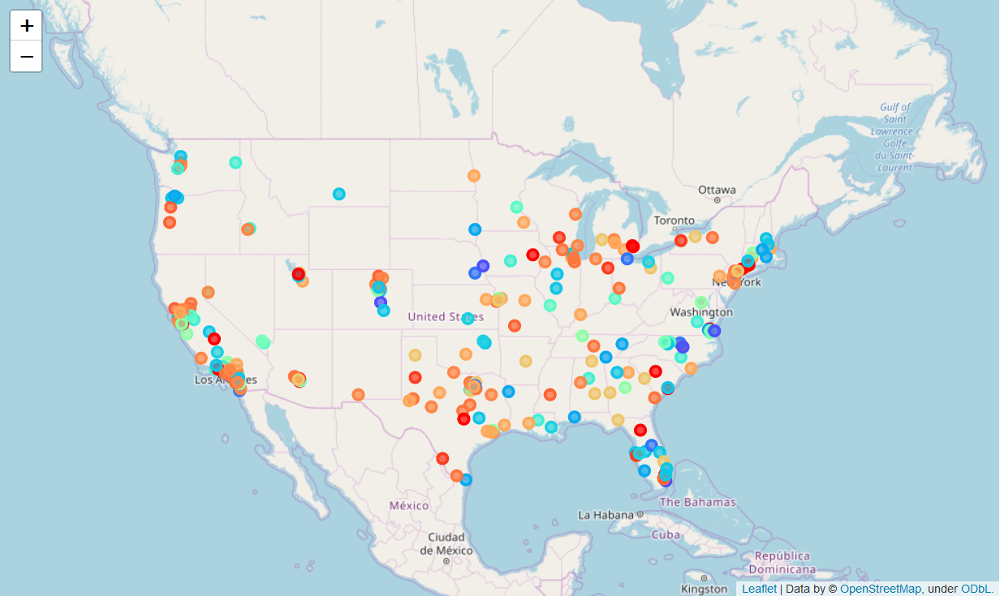

In [48]:
#show folium map
from IPython.display import Image
Image("pictures/4.png")

In [49]:
# select a single city from the dataset to get it's cluster label
cities_final2.loc[cities_final2['Location'] == 'Miami,FL']

,Cluster Labels,Location,City Latitude,City Longitude
15064,5,"Miami,FL",25.774266,-80.193659


In [50]:
# search the data frame for all cities with that cluster label to get recommendations.
cities_final2.loc[cities_final2['Cluster Labels'] ==5]

,Cluster Labels,Location,City Latitude,City Longitude
4894,5,"Colorado Springs,CO",38.833958,-104.825349
13663,5,"Long Beach,CA",33.769016,-118.191605
15064,5,"Miami,FL",25.774266,-80.193659
17519,5,"Omaha,NE",41.258746,-95.938376
19791,5,"Raleigh,NC",35.780398,-78.639099
26167,5,"Virginia Beach,VA",36.852984,-75.977418


This study allows us to use Foursqaure and population data to recommend cities for people that will be moving, specifically retirees. We can see from above some options for someone who wants to retire in a place similar to Miami, FL. 